In [3]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [4]:
import openslide
from pathlib import Path
import pyvips
from tqdm import tqdm
from openslide import OpenSlide
import numpy as np

## Convert 4Scanner

In [51]:
for slide_path in tqdm(list(Path("D:\Datasets/ScannerStudy").glob("*/*/*.svs"))
                       + list(Path("D:\Datasets/ScannerStudy").glob("*/*/*.tif"))
                       + list(Path("D:\Datasets/ScannerStudy").glob("*/*/*.ndpi"))):
    
    slide = OpenSlide(str(slide_path))
    
    thumbnail_size = 4096
    while True:
        np_image = np.array(slide.get_thumbnail(size=(thumbnail_size, thumbnail_size)))
        if np_image.shape[0] < 4096 or np_image.shape[1] < 4096:
            thumbnail_size += 1024
        else:
            break
    
    height, width, bands = np_image.shape
    linear = np_image.reshape(width * height * bands)
    vi = pyvips.Image.new_from_memory(np.ascontiguousarray(linear.data), width, height, bands, 'uchar')
    
    target_folder = Path(r"D:\ProgProjekte\Python\Promotion\WsiRegistration\examples\4Scanner")
    target_folder = target_folder / slide_path.parts[-3] / slide_path.parts[-2]
    target_folder.mkdir(exist_ok=True, parents=True)

    target_file = str(target_folder / slide_path.parts[-1])
        
    vi.tiffsave(target_file, tile=True, compression="jpeg", Q=85, bigtiff=True, pyramid=True, tile_width=256, tile_height=256)

100%|███████████████████████████████████████████████████████████████████████████████| 40/40 [1:20:27<00:00, 120.68s/it]


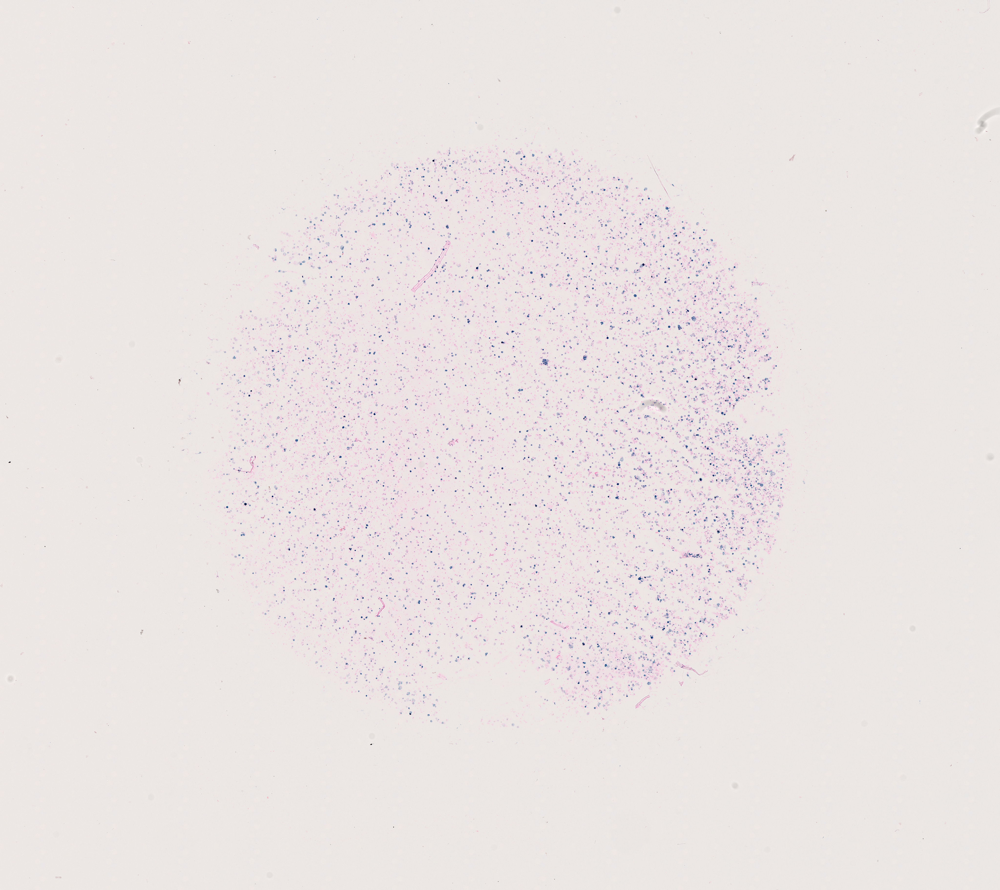

In [52]:
slide.get_thumbnail(size=(4096, 4096))

## Convert D2-40

In [6]:
list(Path("D:\Datasets\ColonCancer\MultiSlide").glob("*/*.tif")) + list(Path("D:\Datasets\ColonCancer\SingleSlide").glob("*/*.tif"))

[WindowsPath('D:/Datasets/ColonCancer/MultiSlide/HE/CRC-A1-1 HE.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/HE/CRC-A1-10 HE.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/HE/CRC-A1-13 HE.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/HE/CRC-A1-2 HE.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/HE/CRC-A1-5 HE.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/IHC/CRC-A1-1.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/IHC/CRC-A1-10.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/IHC/CRC-A1-13.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/IHC/CRC-A1-2.tif'),
 WindowsPath('D:/Datasets/ColonCancer/MultiSlide/IHC/CRC-A1-5.tif'),
 WindowsPath('D:/Datasets/ColonCancer/SingleSlide/HE/CRC-AI-11 F X40.tif'),
 WindowsPath('D:/Datasets/ColonCancer/SingleSlide/HE/CRC-AI-14 1G X40.tif'),
 WindowsPath('D:/Datasets/ColonCancer/SingleSlide/HE/CRC-AI-15 X40.tif'),
 WindowsPath('D:/Datasets/ColonCancer/SingleSlide/HE/CRC-AI-8 E X40.t

In [7]:
for slide_path in tqdm(list(Path("D:\Datasets\ColonCancer\MultiSlide").glob("*/*.tif"))
                       + list(Path("D:\Datasets\ColonCancer\SingleSlide").glob("*/*.tif"))):
    
    slide = OpenSlide(str(slide_path))
    
    thumbnail_size = 4096
    while True:
        np_image = np.array(slide.get_thumbnail(size=(thumbnail_size, thumbnail_size)))
        if np_image.shape[0] < 4096 or np_image.shape[1] < 4096:
            thumbnail_size += 1024
        else:
            break
    
    height, width, bands = np_image.shape
    linear = np_image.reshape(width * height * bands)
    vi = pyvips.Image.new_from_memory(np.ascontiguousarray(linear.data), width, height, bands, 'uchar')
    
    target_folder = Path(r"D:\ProgProjekte\Python\Promotion\WsiRegistration\examples\IHC")
    target_folder = target_folder / slide_path.parts[-3] / slide_path.parts[-2]
    target_folder.mkdir(exist_ok=True, parents=True)

    target_file = target_folder / slide_path.parts[-1]
        
    vi.tiffsave(str(target_file), tile=True, compression="jpeg", Q=85, bigtiff=True, pyramid=True, tile_width=256, tile_height=256)

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [02:32<00:00,  7.61s/it]


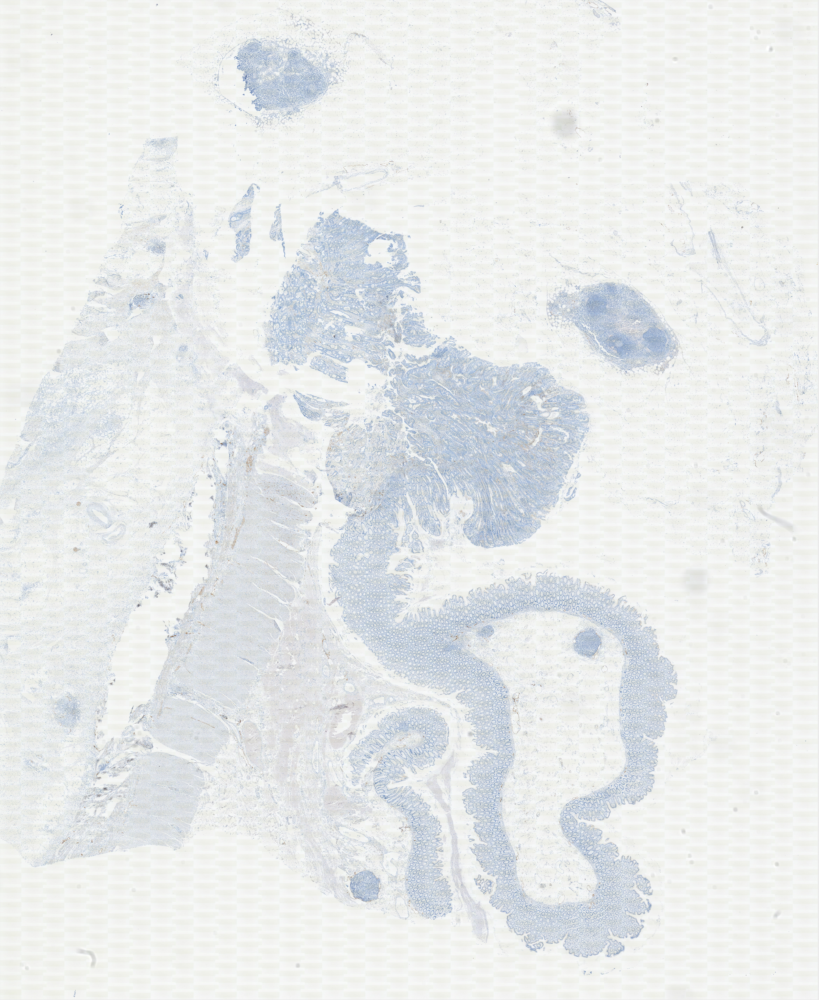

In [8]:
slide.get_thumbnail(size=(4096, 4096))